# Build Decision Tree to Predict UCI Wine Quality

## 1. Prepare dataset (UCI Wine Quality)

In [1]:
# import the dataset: Wine Quality
from ucimlrepo import fetch_ucirepo
wine_quality_dataset = fetch_ucirepo(name="Wine Quality")

quantity per class: [0, 0, 0, 30, 216, 2138, 2836, 1079, 193, 5]


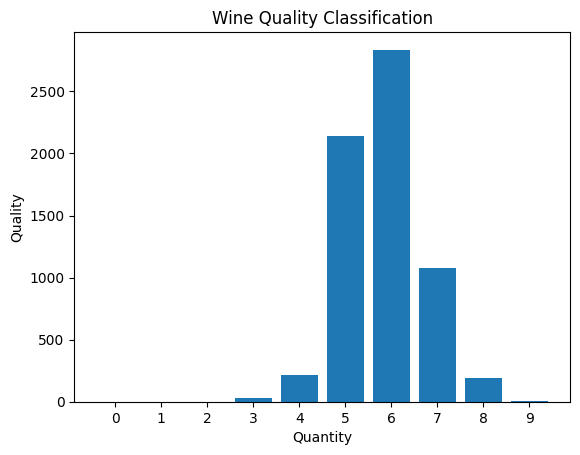

In [2]:
# visualize original data
import matplotlib.pyplot as plt

plt.close('all')
count = [0] * 10

for i in wine_quality_dataset.data.targets.values:
    count[int(i[0])] += 1

print('quantity per class:', count)

plt.title('Wine Quality Classification')
plt.bar(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9'], count)
plt.xlabel('Quantity')
plt.ylabel('Quality')
plt.show()


[246, 4974, 1277]


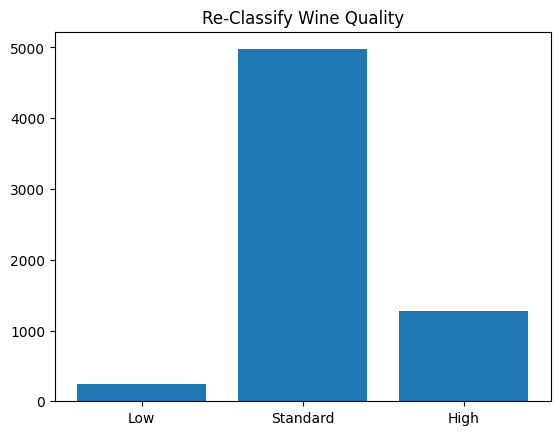

In [3]:
# classify label from 11 class (0 - 10) to 3 class: (0 - 4: Low quality [0]), (5 - 6: Standard Quality [1]), (7 - 10: High Quality [2])
# and visualize alternate dataset

import copy
alter_dataset = copy.deepcopy(wine_quality_dataset)
count = [0, 0 ,0]

for i in range(len(alter_dataset.data.targets.values)):
    if alter_dataset.data.targets.values[i] >= 0 and alter_dataset.data.targets.values[i] < 5:
        alter_dataset.data.targets.values[i] = 0
        count[0] += 1
    elif alter_dataset.data.targets.values[i] > 4 and alter_dataset.data.targets.values[i] < 7:
        alter_dataset.data.targets.values[i] = 1
        count[1] += 1
    else:
        alter_dataset.data.targets.values[i] = 2
        count[2] += 1

print(count)
plt.close('all')
plt.bar(['Low', 'Standard', 'High'], count)
plt.title('Re-Classify Wine Quality')
plt.show()

In [4]:
# split the dataset to train data and test data in 4 propotion 40/60 60/40 80/20 90/10
from sklearn.model_selection import train_test_split

feature = alter_dataset.data.features
target = alter_dataset.data.targets
propotions = [0.6, 0.4, 0.2, 0.1]

feature_train = []
feature_test = []
label_train = []
label_test = []

for i in range(4):
    x_train, x_test, y_train, y_test = train_test_split(feature, target, test_size=propotions[i], stratify=target)
    feature_train.append(x_train)
    feature_test.append(x_test)
    label_train.append(y_train)
    label_test.append(y_test)

In [5]:
# visualize 16 subset


## 2. Build the decision tree classifiers

In [6]:
# build the tree
from sklearn.tree import DecisionTreeClassifier

clf = []
for i in range(4):
    clf.append(DecisionTreeClassifier(criterion='entropy')) # make decision tree with information gain
    clf[i] = clf[i].fit(feature_train[i], label_train[i])

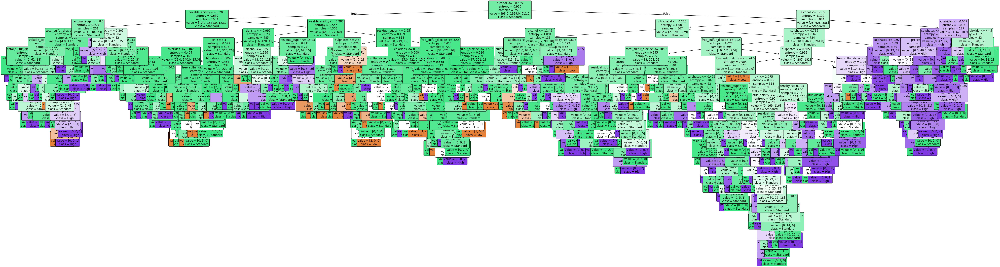

In [7]:
# visualize 4 tree
# Tree with proportion 40/60
from sklearn import tree

fig = plt.figure(figsize=(75, 20))
var_name = alter_dataset.variables.name[:11]

_ = tree.plot_tree(clf[0],
                    feature_names=var_name,
                    class_names={0: 'Low', 1: 'Standard', 2: 'High'},
                    filled=True,
                    rounded=True,
                    fontsize=12)

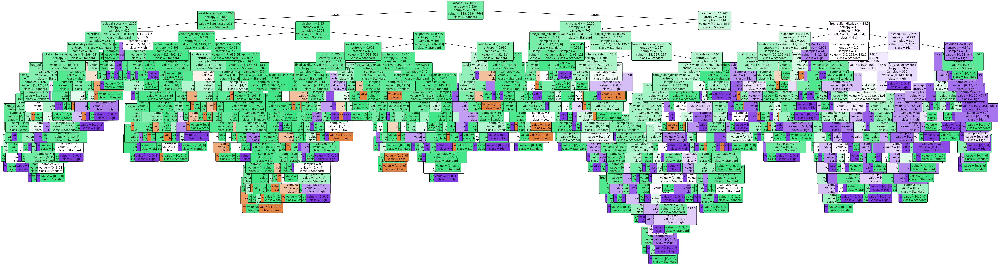

In [8]:
# Tree with proportion 60/40
fig = plt.figure(figsize=(75, 20))
_ = tree.plot_tree(clf[1],
                    feature_names=var_name,
                    class_names={0: 'Low', 1: 'Standard', 2: 'High'},
                    filled=True,
                    rounded=True,
                    fontsize=12)

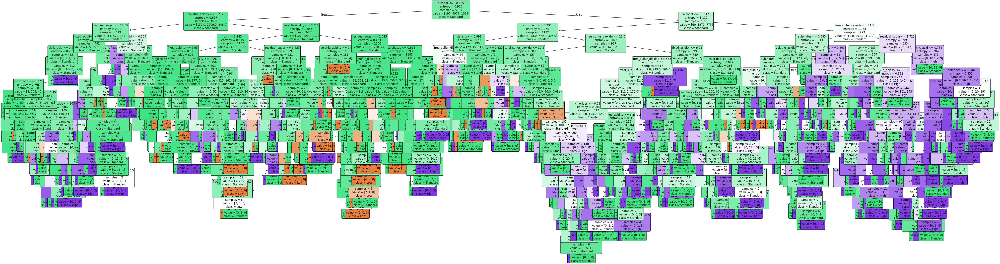

In [9]:
# Tree with proportion 80/20
fig = plt.figure(figsize=(75, 20))
_ = tree.plot_tree(clf[2],
                    feature_names=var_name,
                    class_names={0: 'Low', 1: 'Standard', 2: 'High'},
                    filled=True,
                    rounded=True,
                    fontsize=12)

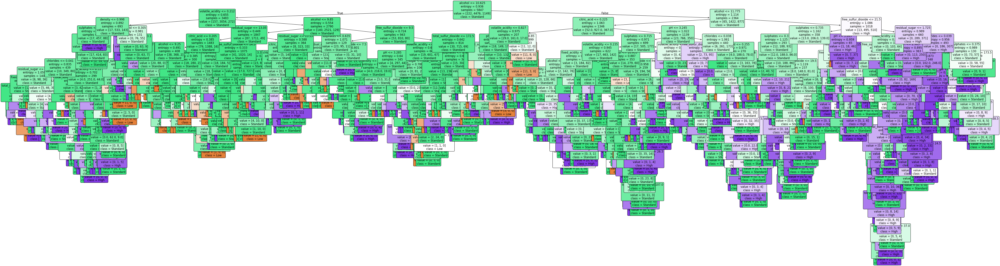

In [10]:
# Tree with proportion 90/10
fig = plt.figure(figsize=(75, 20))
_ = tree.plot_tree(clf[3],
                    feature_names=var_name,
                    class_names={0: 'Low', 1: 'Standard', 2: 'High'},
                    filled=True,
                    rounded=True,
                    fontsize=12)


## 3. Evaluate decision tree classifiers

In [11]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

# predictions base on trained model of corresponding test set
predictss = []
for i in range(4):
    predictss.append(clf[i].predict(feature_test[i]))


Report and confusion matrix of subset 1: 40/60

              precision    recall  f1-score   support

         Low       0.16      0.14      0.15       148
    Standard       0.84      0.85      0.85      2985
        High       0.52      0.52      0.52       766

    accuracy                           0.76      3899
   macro avg       0.51      0.50      0.51      3899
weighted avg       0.75      0.76      0.76      3899



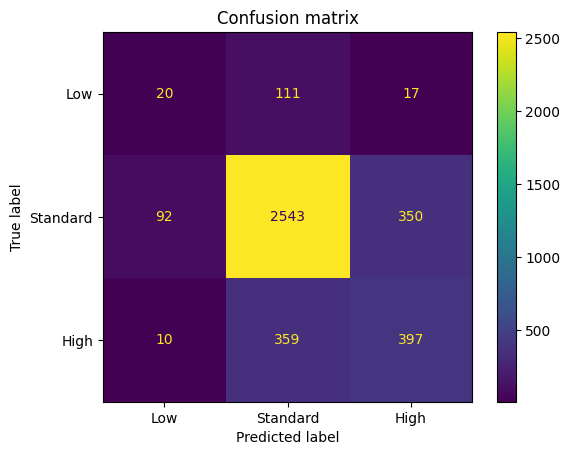

In [12]:
# evaluate each split set
print("Report and confusion matrix of subset 1: 40/60\n")
print(classification_report(label_test[0], predictss[0], target_names=['Low', 'Standard', 'High'], zero_division=1.0))

cm = confusion_matrix(label_test[0], predictss[0])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Low', 'Standard', 'High'])
disp.plot()
plt.title("Confusion matrix")
plt.show()

Report and confusion matrix of subset 2: 60/40

              precision    recall  f1-score   support

         Low       0.23      0.24      0.24        98
    Standard       0.86      0.86      0.86      1990
        High       0.58      0.55      0.56       511

    accuracy                           0.78      2599
   macro avg       0.55      0.55      0.55      2599
weighted avg       0.78      0.78      0.78      2599



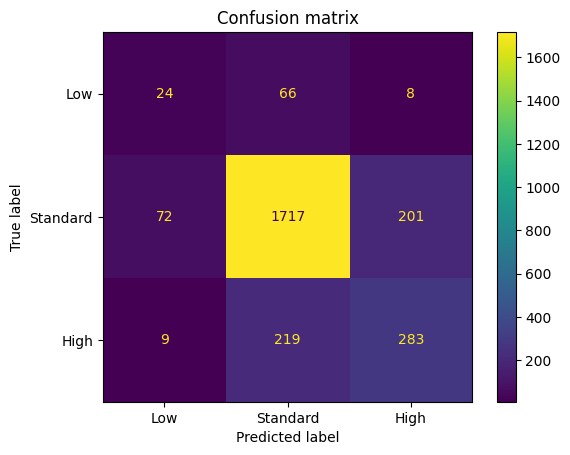

In [13]:
# evaluate each split set
print("Report and confusion matrix of subset 2: 60/40\n")
print(classification_report(label_test[1], predictss[1], target_names=['Low', 'Standard', 'High'], zero_division=1.0))

cm = confusion_matrix(label_test[1], predictss[1])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Low', 'Standard', 'High'])
disp.plot()
plt.title("Confusion matrix")
plt.show()

Report and confusion matrix of subset 3: 80/20

              precision    recall  f1-score   support

         Low       0.20      0.18      0.19        49
    Standard       0.86      0.87      0.86       995
        High       0.60      0.58      0.59       256

    accuracy                           0.79      1300
   macro avg       0.55      0.54      0.55      1300
weighted avg       0.78      0.79      0.78      1300



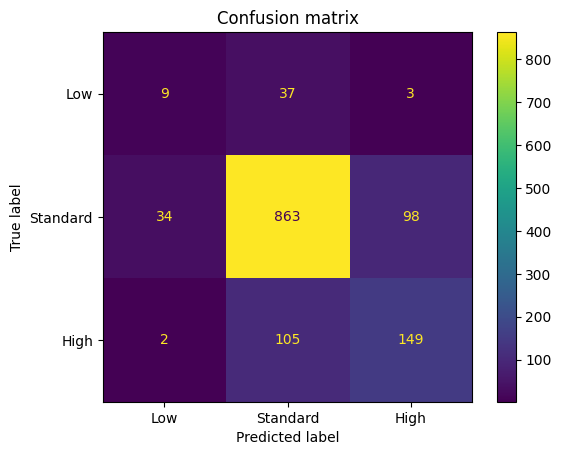

In [14]:
# evaluate each split set
print("Report and confusion matrix of subset 3: 80/20\n")
print(classification_report(label_test[2], predictss[2], target_names=['Low', 'Standard', 'High'], zero_division=1.0))

cm = confusion_matrix(label_test[2], predictss[2])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Low', 'Standard', 'High'])
disp.plot()
plt.title("Confusion matrix")
plt.show()

Report and confusion matrix of subset 4: 90/10

              precision    recall  f1-score   support

         Low       0.32      0.25      0.28        24
    Standard       0.87      0.89      0.88       498
        High       0.64      0.62      0.63       128

    accuracy                           0.81       650
   macro avg       0.61      0.59      0.60       650
weighted avg       0.81      0.81      0.81       650



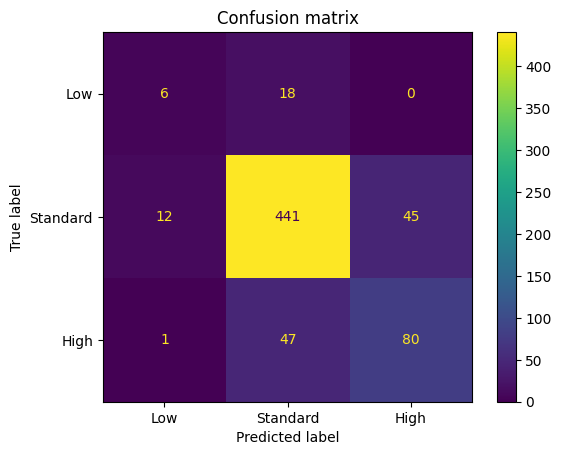

In [15]:
# evaluate each split set
print("Report and confusion matrix of subset 4: 90/10\n")
print(classification_report(label_test[3], predictss[3], target_names=['Low', 'Standard', 'High'], zero_division=1.0))

cm = confusion_matrix(label_test[3], predictss[3])
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['Low', 'Standard', 'High'])
disp.plot()
plt.title("Confusion matrix")
plt.show()


## 4. The depth and accuracy of a decision tree

In [16]:
# build decision tree for each depth
max_depth = [None, 2, 3, 4, 5, 6, 7]

clf_82 = []
for i in range(len(max_depth)):
    clf_82.append(DecisionTreeClassifier(criterion='entropy', max_depth=max_depth[i]))
    clf_82[i].fit(feature_train[2], label_train[2])

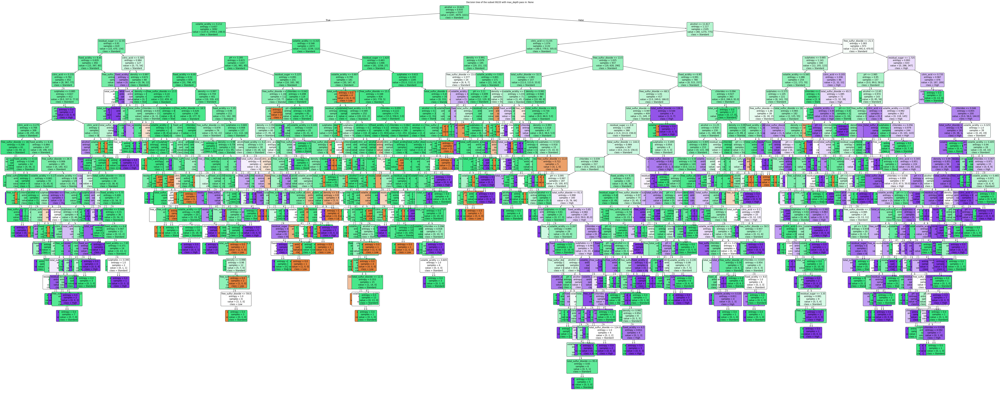

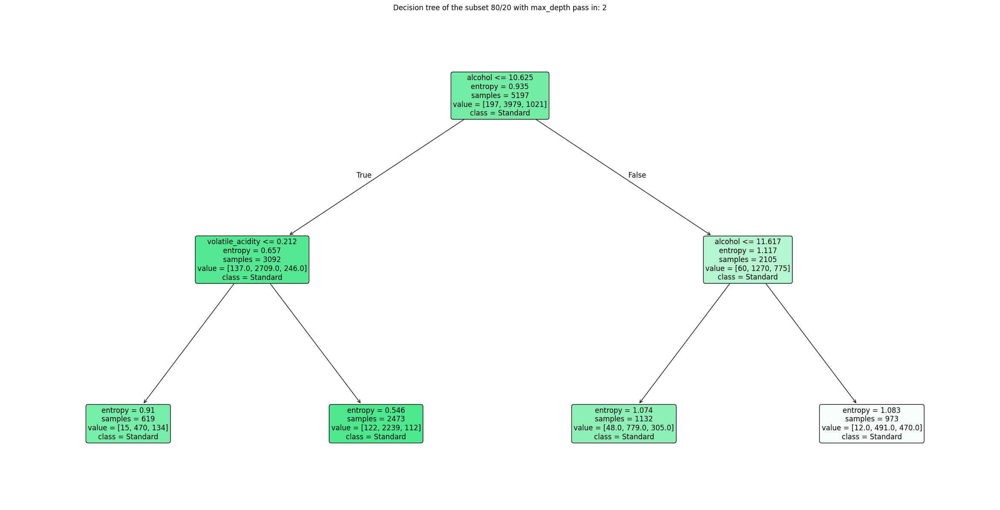

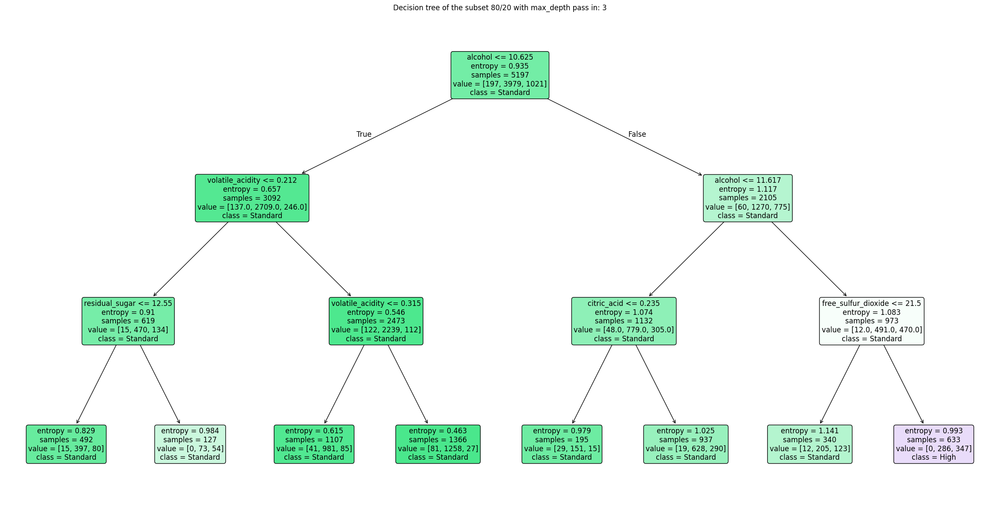

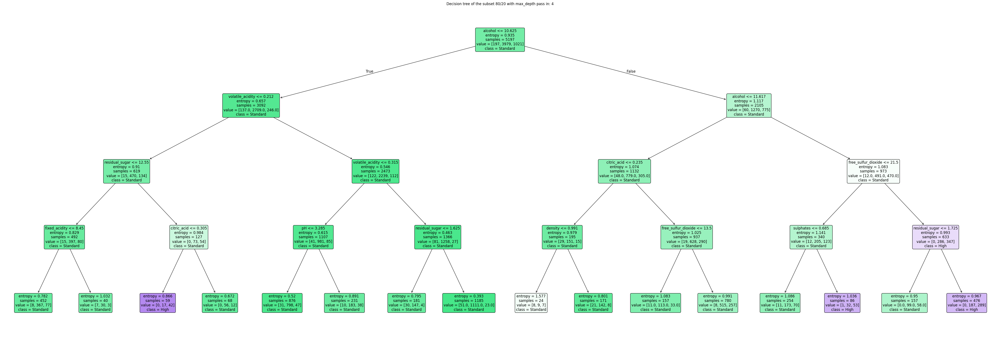

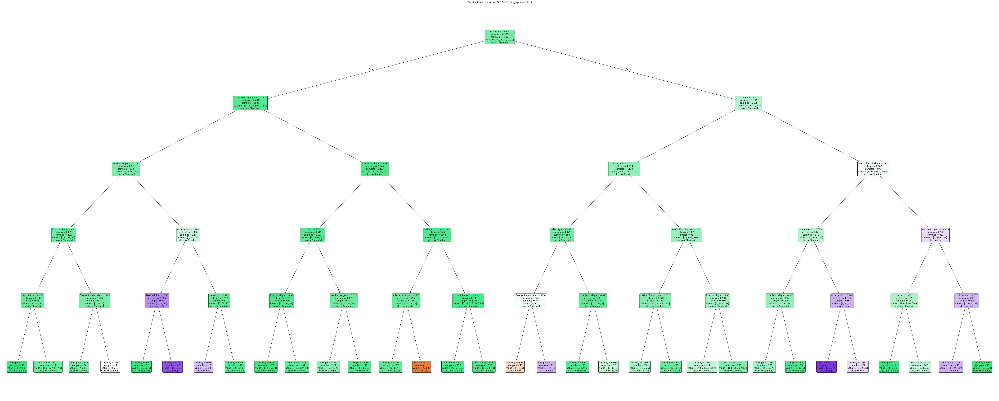

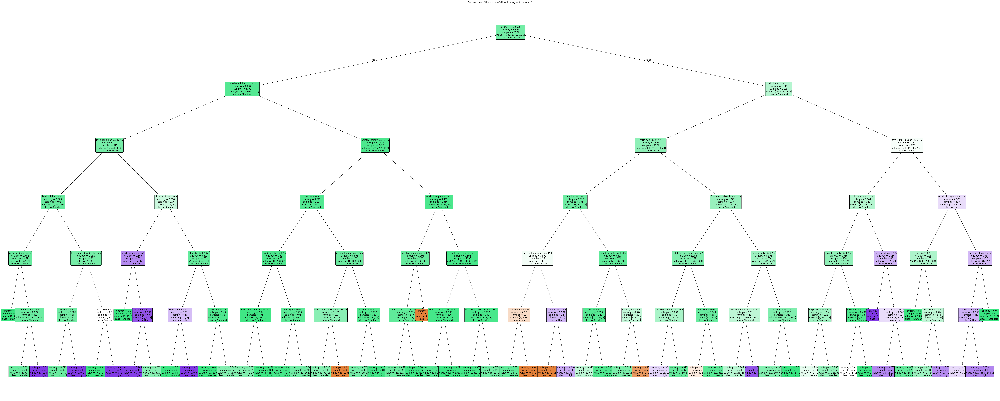

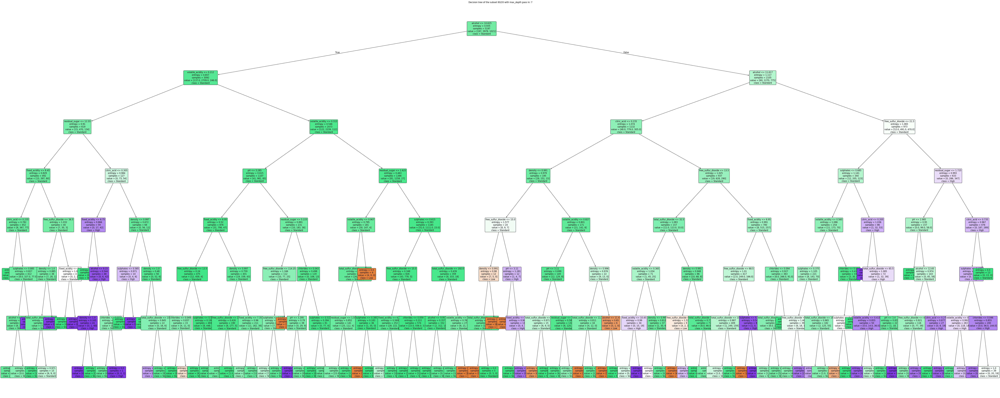

In [17]:
# Display all the tree each depth value
def visDecisionTree(clf, depth):
    width = 100
    height = 40

    if depth is None:
        pass
    elif depth > 0 and depth < 4:
        width, height = 30, 15
    elif depth >= 4 and depth < 5:
        width, height = 60, 20

    fig = plt.figure(figsize=(width, height))
    _ = tree.plot_tree(clf,
                    feature_names=var_name,
                    class_names={0: 'Low', 1: 'Standard', 2: 'High'},
                    filled=True,
                    rounded=True,
                    fontsize=12)
    
    s = 'None' if depth is None else str(depth)
    plt.title('Decision tree of the subset 80/20 with max_depth pass in: ' + s)
    plt.show()

    
for i in range(len(max_depth)):
    visDecisionTree(clf_82[i], max_depth[i])

In [20]:
# collect report on each depth value
from sklearn.metrics import accuracy_score

accuracy_scores = {}
for i in range(len(clf_82)):
    key = 'None'
    if i > 0: key = i + 1
    accuracy_scores[key] = accuracy_score(label_test[2], clf_82[i].predict(feature_test[2]))

print(accuracy_scores)

{'None': 0.7769230769230769, 2: 0.7653846153846153, 3: 0.7707692307692308, 4: 0.7992307692307692, 5: 0.7984615384615384, 6: 0.8007692307692308, 7: 0.8038461538461539}
